## Overview
This notebook is a practice of building and training the CycleGAN model to generate imitated Monet painting from regular photos. The practice is based on a Kaggle competition, and the data can be obtained from the competition website at https://www.kaggle.com/competitions/gan-getting-started/data.

This notebook can also be found at https://github.com/Lorby04/msds/tree/main/dl/week5 and https://www.kaggle.com/code/lorbybi/monet-painting-with-gan


In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
#for dirname, _, filenames in os.walk('/kaggle/input'):
#    for filename in filenames[:1]:
#        print(os.path.join(dirname, filename))
         
    
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import tensorflow as tf

import pathlib
import time
import datetime

from matplotlib import pyplot as plt
from IPython import display

In [3]:
#Try to get TPU, refer to the tutorial:https://www.kaggle.com/code/amyjang/monet-cyclegan-tutorial/notebook
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE
    
print(tf.__version__)

Number of replicas: 1
2.11.0


1. Data preparing

Downloading data from the source, extract the compressed files to local disk.


In [4]:
data_root_dir = "./gan-getting-started/" #"/kaggle/input/gan-getting-started/"
data_dir = data_root_dir

In [5]:
def download_data():
    dataset_url =  "https://www.kaggle.com/competitions/gan-getting-started/data"
    cmd = "pip install opendatasets"
    os.system(cmd)
    import opendatasets as od
    od.download(dataset_url)


In [6]:
if not os.path.exists(data_dir):
    download_data()

In [7]:
monet_jpg_dir = data_root_dir + "monet_jpg/"  
monet_tfrec_dir = data_root_dir + "monet_tfrec/" #Training dataset
photo_jpg_dir = data_root_dir + "photo_jpg/"  
photo_tfrec_dir = data_root_dir + "photo_tfrec/" #Testing dataset

train_path = pathlib.Path(monet_tfrec_dir).with_suffix('')
test_path = pathlib.Path(photo_tfrec_dir).with_suffix('')

In [8]:
import PIL
from PIL import Image
def show_image(photo_dir):
    fig_width = 2
    fig_height = 2
    fig = plt.figure(figsize=(16,16))
    ax = fig.subplots(fig_height,fig_width)

    i = 0
    for fn in os.listdir(photo_dir):
        with Image.open(os.path.join(photo_dir, fn)) as img:
            r = i // fig_width
            c = i % fig_width
            ax[r][c].imshow(img)
            ax[r][c].set_title(os.path.join(photo_dir, fn))

        i = i+1
        if i >= fig_width * fig_height:
            break

## Exploratory Data Analysis (EDA)
The dataset includes the real painting from Monet which is taken as training dataset in this notebook. The dataset also includes 7000+ photos to be taken as testing dataset.
At the end of the notebook, the trained generator will be used to generate Monet painting from the testing dataset.

First, let's take a look at some Monet paintings to have some impression of how it looks like.

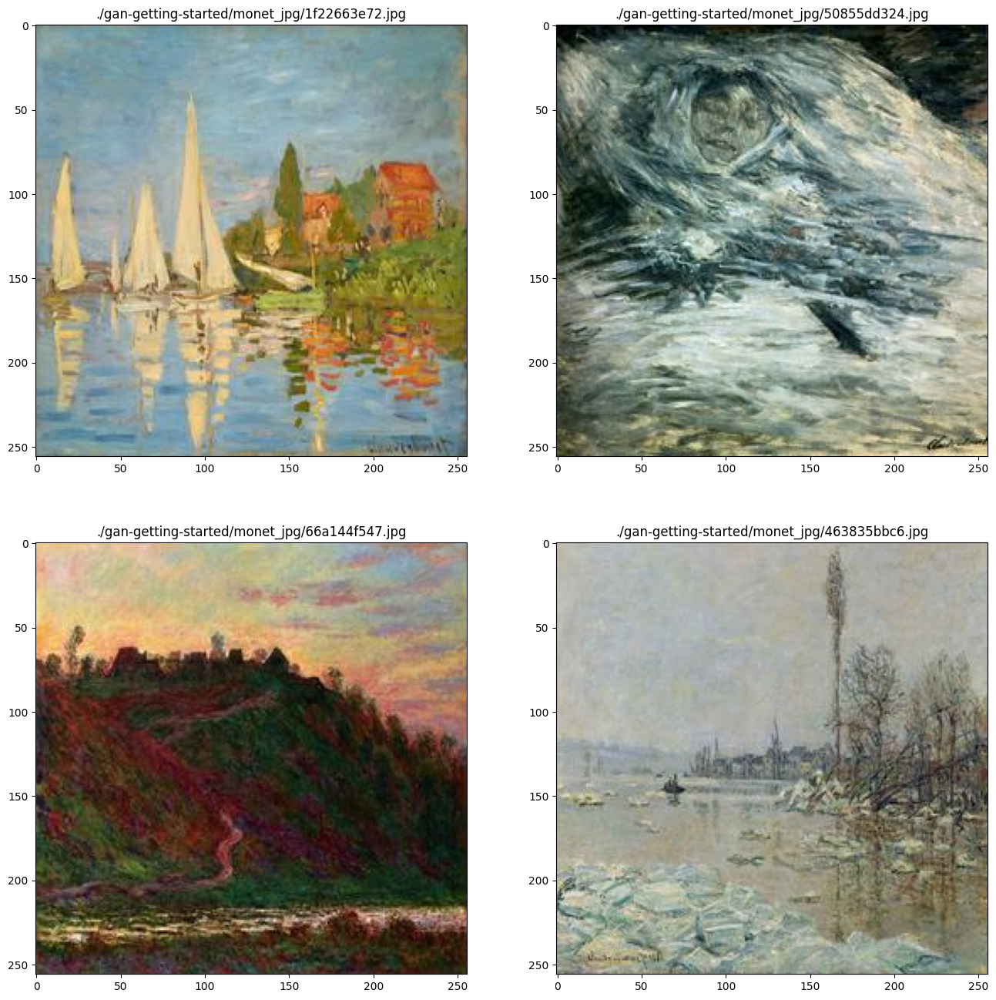

In [9]:
show_image(monet_jpg_dir)

Then, have another look at the regular photos to compare with the paintings.

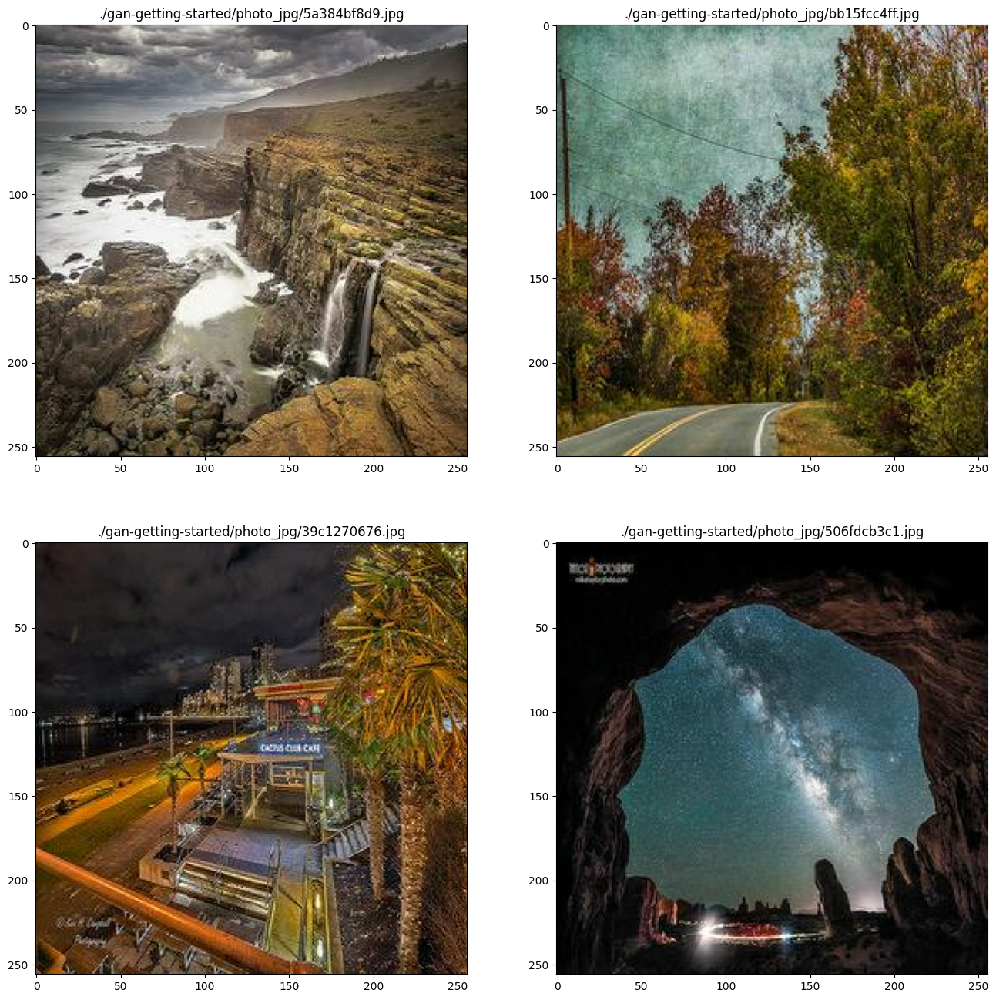

In [10]:
show_image(photo_jpg_dir)

The original dataset includes both jpeg format and compressed TFRecord format. To be sake of the performance, the tfrec format will be used for training.

In [11]:
train_tfrec_files = list(train_path.glob('*.tfrec'))
test_tfrec_files = list(test_path.glob('*.tfrec'))

print("Number of files for training:",len(train_tfrec_files))
print("Number of files for testing:",len(test_tfrec_files))


Number of files for training: 5
Number of files for testing: 20


In [12]:
for train_f in train_tfrec_files:
    print(train_f)

gan-getting-started/monet_tfrec/monet00-60.tfrec
gan-getting-started/monet_tfrec/monet16-60.tfrec
gan-getting-started/monet_tfrec/monet08-60.tfrec
gan-getting-started/monet_tfrec/monet04-60.tfrec
gan-getting-started/monet_tfrec/monet12-60.tfrec


Load dataset from tfrecord files, refer to :https://www.kaggle.com/code/amyjang/monet-cyclegan-tutorial

In [13]:
tfrec_features = {
    "image_name": tf.io.FixedLenFeature([], tf.string),
    "image": tf.io.FixedLenFeature([], tf.string),
    "target": tf.io.FixedLenFeature([], tf.string)
}

In [14]:

img_size = (256, 256)

def decode_image(image):
    image = tf.image.decode_jpeg(image, channels=3)
    #image = (tf.cast(image, tf.float32) / (255./2)) - 1
    image = tf.reshape(image, [*img_size, 3])
    return image

def read_image(fn):
    features = tfrec_features
    example = tf.io.parse_single_example(fn, features)
    image = decode_image(example['image'])
    return image

def read_id(fn):
    features = tfrec_features
    example = tf.io.parse_single_example(fn, features)
    return example['image_name']

def load_dataset_image(filenames):
    dataset = tf.data.TFRecordDataset(filenames)
    dataset = dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)
    return dataset

def load_dataset_id(filenames):
    dataset = tf.data.TFRecordDataset(filenames)
    dataset = dataset.map(read_id, num_parallel_calls=tf.data.AUTOTUNE)
    return dataset

In [15]:
batch_size = 1
train_ds = load_dataset_image(train_tfrec_files).batch(batch_size)
test_ds = load_dataset_image(test_tfrec_files).batch(batch_size)

train_id_ds = load_dataset_id(train_tfrec_files).batch(batch_size)
test_id_ds = load_dataset_id(test_tfrec_files).batch(batch_size)

Metal device set to: Apple M1


2023-02-21 17:21:59.429898: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-02-21 17:21:59.429916: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [16]:
def show_raw_image(ids, images, jpg_dir, recover = None):
    assert((ids == None) or (len(ids) == len(images)))
    num = min(len(images), 3)    
    
    fig_width = 1 if ids==None else 2
    fig_height = num
    fig = plt.figure(figsize=(16,16))
    ax = fig.subplots(fig_height,fig_width)

    recover_image = lambda img:img if recover==None else recover(img)
    
    for i in range(num):
        id = "Random" if ids == None else ids[i].numpy().decode()      
        pos = lambda i, c, n: ax[i][c] if ((n>1) and (fig_width > 1)) else ax[c] if ((n==1) and (fig_width>1)) else ax[i] if((n>1)and(fig_width==1)) else ax
        #Show raw image from dataset
        pos(i,0,num).imshow(recover_image(images[i].numpy()))
        pos(i,0,num).set_title(id + ": processed")

        #Show original image from jpeg format
        if (jpg_dir != None):
            fn = id +".jpg"
            fullname = os.path.join(jpg_dir, fn)
            with Image.open(fullname) as img:
                pos(i,1,num).imshow((img))
                pos(i,1,num).set_title(fullname + ": origin")


To make sure the trfec files are the same as the corresponding jpeg files, pickup 1 from each set to perform side by side checking.
In the below output, the left side is from trfec and the right side is from jpeg files.
It looks to be the same.

2023-02-21 17:21:59.544763: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


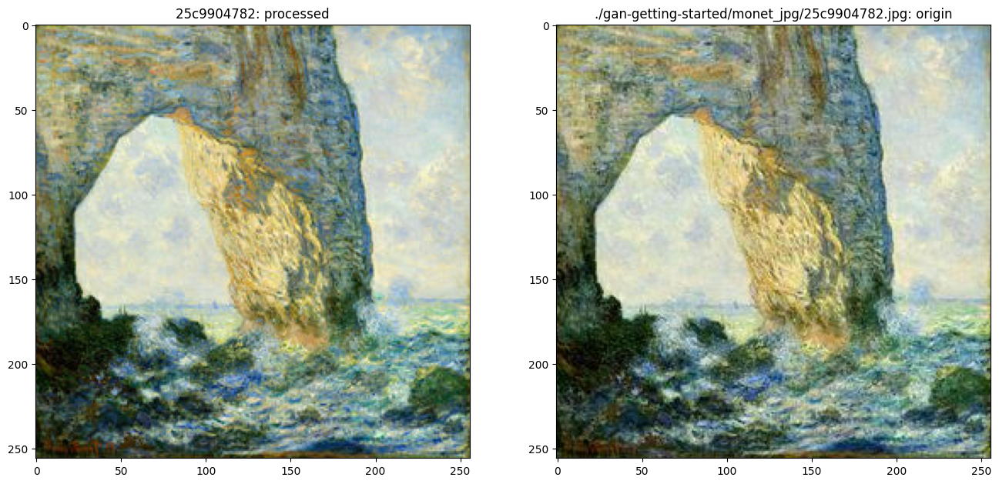

In [17]:
show_raw_image(next(iter(train_id_ds)), next(iter(train_ds)), monet_jpg_dir)

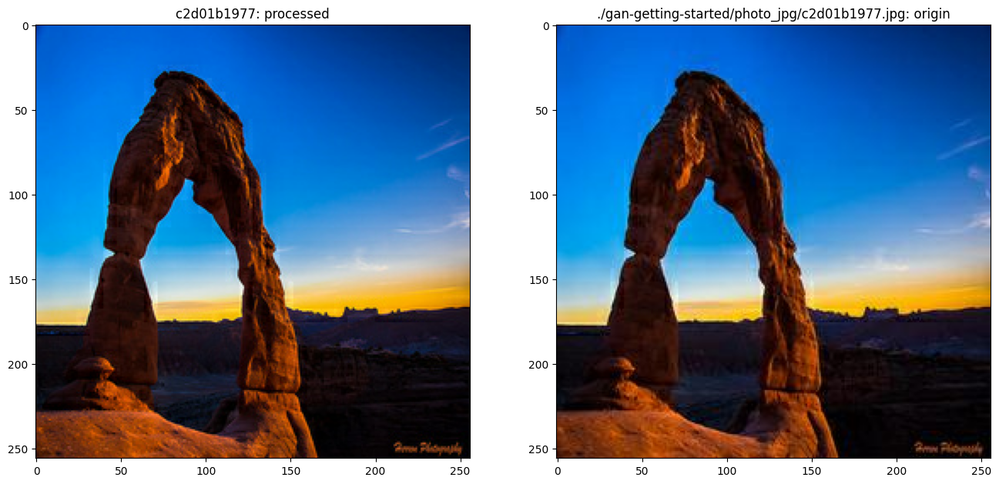

In [18]:
show_raw_image(next(iter(test_id_ds)), next(iter(test_ds)), photo_jpg_dir)

## Model Architecture and Training Methods

Refer to the tutorial https://www.tensorflow.org/tutorials/generative/cyclegan?authuser=8, this notenook builds and train the CycleGan model with unet, the main model and generator are imported and reused from the pix2pix models with adjustments on the optimizer and loss functions.

As explained in the tutorial:

"

There are 2 generators (G and F) and 2 discriminators (X and Y) being trained here.

Generator G learns to transform image X to image Y. 
Generator F learns to transform image Y to image X. 
Discriminator D_X learns to differentiate between image X and generated image X (F(Y)).
Discriminator D_Y learns to differentiate between image Y and generated image Y (G(X)).


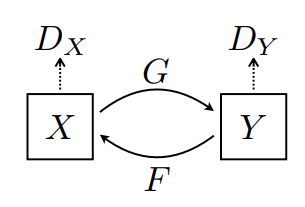

"

In this notebook, here is the mapping between the components of the task and the general concept:
- X <> photo (discriminator)
- Y <> Monet (discriminator)
- G <> From photo to Monet (generator)
- F <> From Monet to photo (generator)


Here is the utility functions to preprocess the images to satisfy the generators refer to the tutorials.

In [19]:
img_height, img_width = 256, 256
def normalize(image):
    return (tf.cast(image, tf.float32) / (255./2)) - 1

def recover(image):
    return image*0.5+0.5

def random_crop(image):
    return tf.image.random_crop(image, size=[img_height, img_width, 3])


resized_height, resized_width = 286,286
#Add random noise to the image
def random_jitter(image):
    # resizing to 286 x 286 x 3
    image = tf.image.resize(image, [resized_height, resized_width],
                          method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

    # randomly cropping to 256 x 256 x 3
    image = random_crop(image)

    # random mirroring
    image = tf.image.random_flip_left_right(image)

    return image

#Add noise to enhace training accuracy
def preprocess_image_train(image):
    image = image[0]
    image = random_jitter(image)
    image = normalize(image)
    return image

#For testing image, just needs to normalize to the same size range as training data
def preprocess_image_test(image):
    image = image[0]
    return normalize(image)


Build the dataset and veirify.

In [20]:
processed_train_ds = train_ds.cache().map(preprocess_image_train, num_parallel_calls=tf.data.AUTOTUNE).batch(1)
processed_test_ds = test_ds.cache().map(preprocess_image_test, num_parallel_calls=tf.data.AUTOTUNE).batch(1)

2023-02-21 17:22:00.626320: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


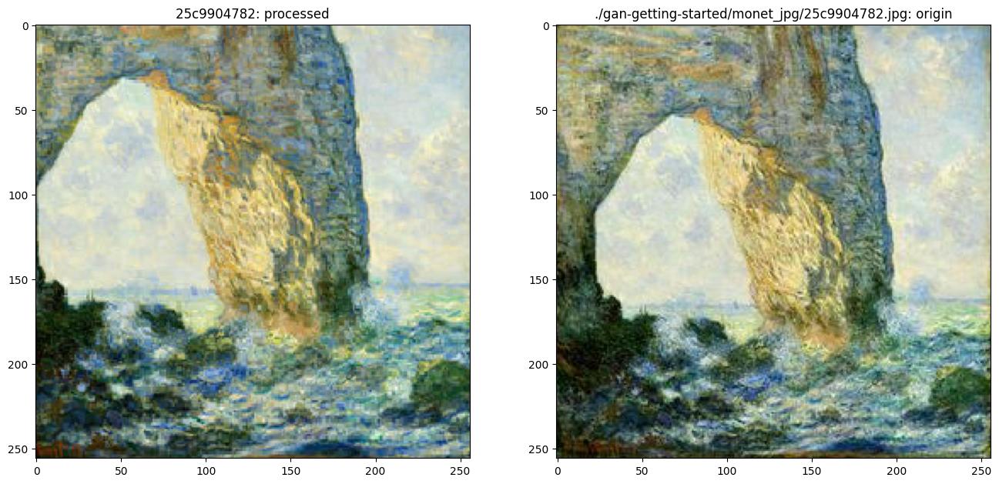

In [21]:
sample_train_id = next(iter(train_id_ds))
sample_train_image = next(iter(processed_train_ds))
show_raw_image(sample_train_id, sample_train_image, monet_jpg_dir, recover)

2023-02-21 17:22:01.129472: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


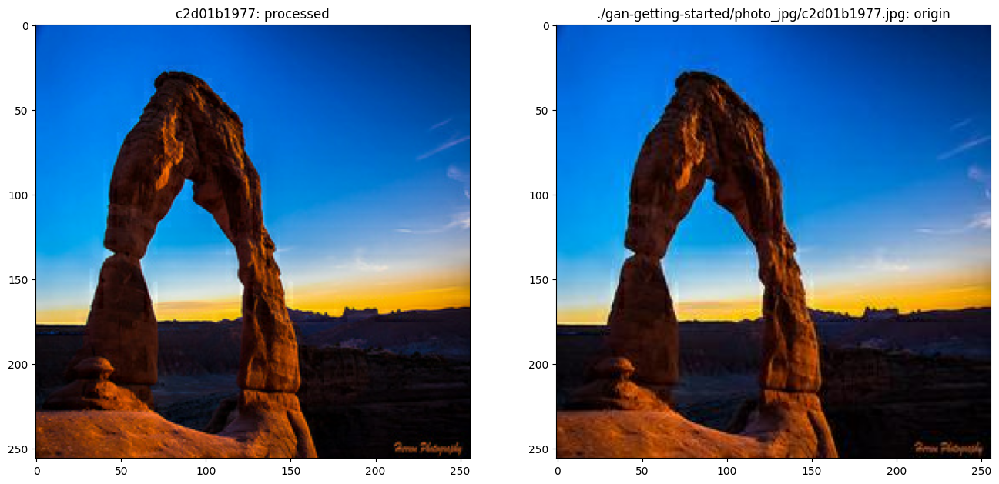

In [22]:
sample_test_id = next(iter(test_id_ds))
sample_test_image = next(iter(processed_test_ds))
show_raw_image(sample_test_id, sample_test_image , photo_jpg_dir, recover)

In [23]:
shuffled_train_ds = processed_train_ds.shuffle(buffer_size = 100)

2023-02-21 17:22:01.631117: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


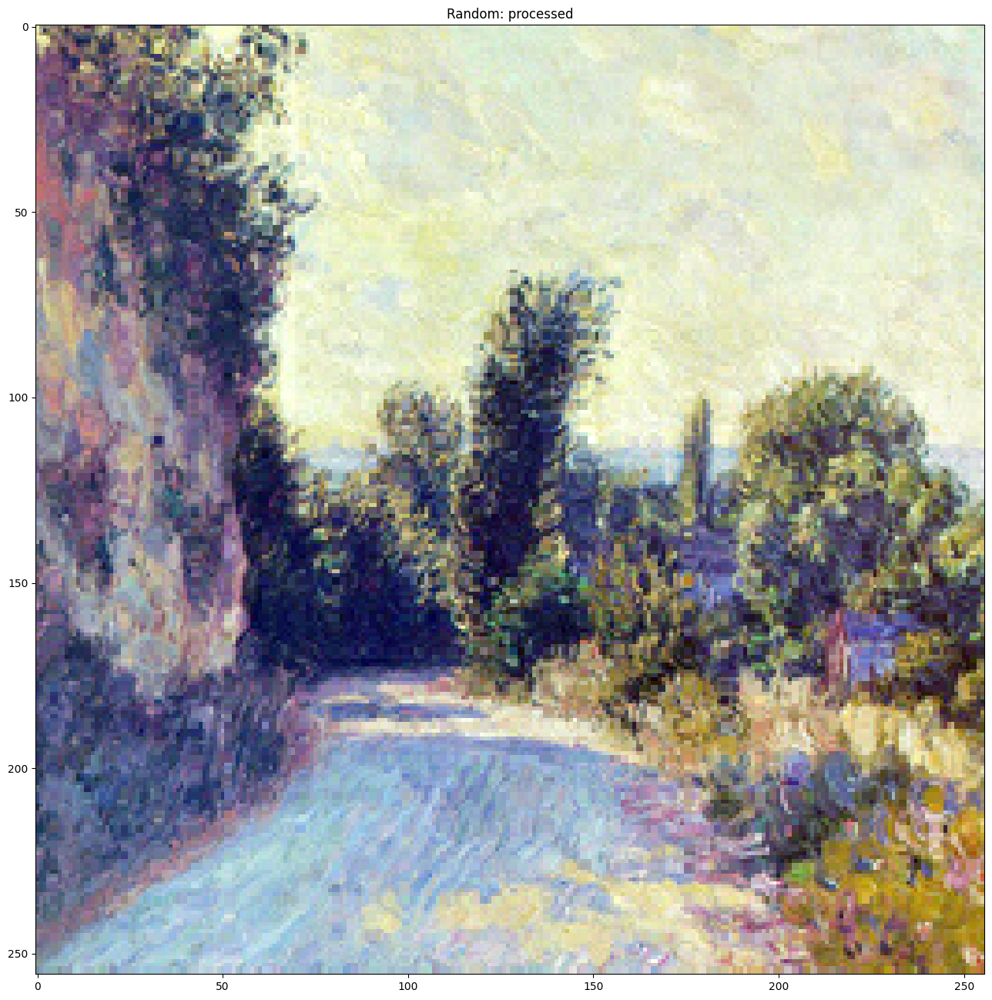

In [24]:
show_raw_image(None, next(iter(shuffled_train_ds)), None, recover)
#After being shuffled, the processed dataset cannot be mapped to the id any more, so the two are different

In [25]:
!pip install git+https://github.com/tensorflow/examples.git

  Cloning https://github.com/tensorflow/examples.git to /private/var/folders/qr/g0b69pq564xg82p0g6bvvwvh0000gn/T/pip-req-build-4jzvwnhn
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/examples.git /private/var/folders/qr/g0b69pq564xg82p0g6bvvwvh0000gn/T/pip-req-build-4jzvwnhn
  Resolved https://github.com/tensorflow/examples.git to commit f2b560e341ee0b21f1b8a0f351077a656fff7336
  Preparing metadata (setup.py) ... done


Import and reuse the models from pix2pix

In [26]:
from tensorflow_examples.models.pix2pix import pix2pix as p2p

In [27]:
#Refer to the tutorial:https://www.tensorflow.org/tutorials/generative/cyclegan?authuser=8
OUTPUT_CHANNELS = 3

monet_generator = p2p.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')
photo_generator = p2p.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')

photo_discriminator = p2p.discriminator(norm_type='instancenorm', target=False)
monet_discriminator = p2p.discriminator(norm_type='instancenorm', target=False)

Before training, generate two sample images between photo and Monet painting along with watching the result of discriminators with respective generator and discriminators, to understand the use of the model.

In [28]:
from_sample_test = monet_generator(sample_test_image) #Generate painting
from_sample_train = photo_generator(sample_train_image) #Generate real image

Compare the generated images (left side) and the original images (right side).
The first one is from photo to Monet painting, and the second one is the reversed direction.

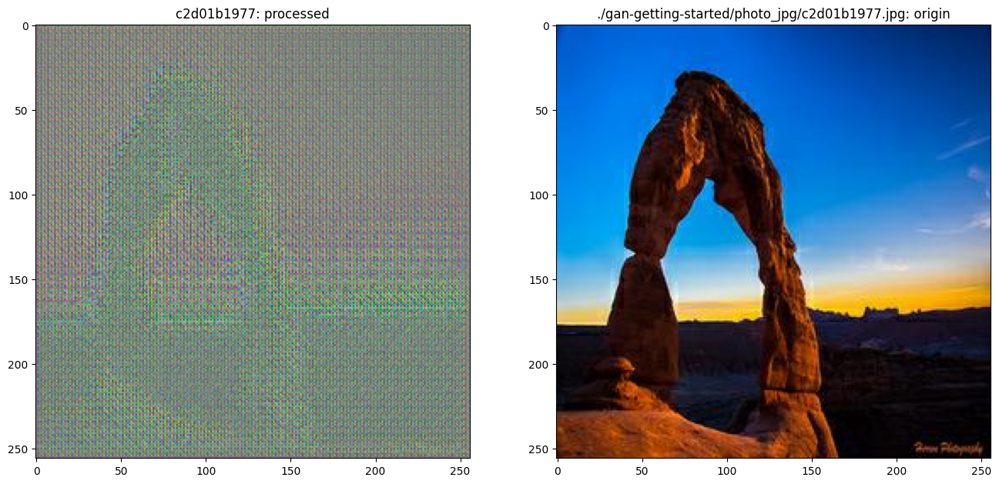

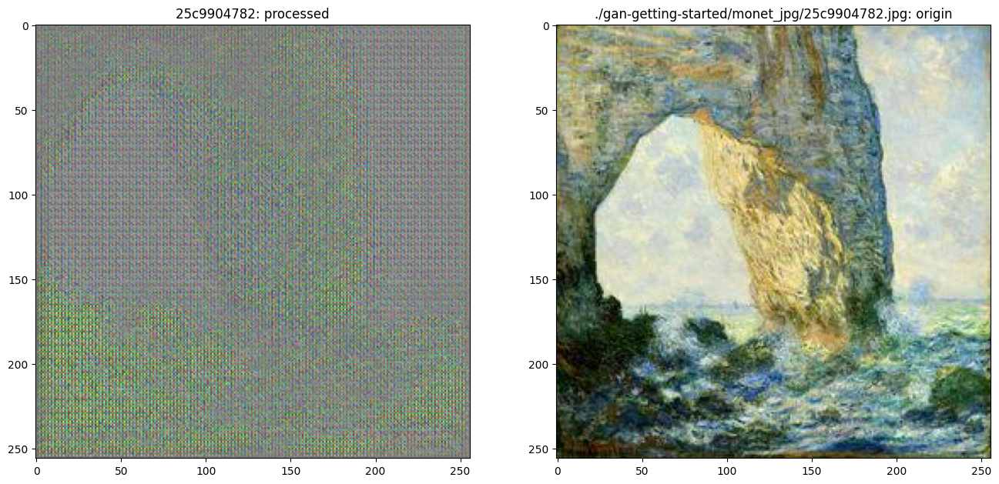

In [29]:
show_raw_image(sample_test_id, from_sample_test, photo_jpg_dir, recover)
show_raw_image(sample_train_id, from_sample_train, monet_jpg_dir, recover)

Performing the generation on the reverse direction with the generated files from the above operation. Check the difference between the regenerated images and the original images.
The first one is the regular photo and the second one is the Monet painting.

Since we didn't train the model yet, the difference is significant.

In [30]:
regen_sample_test = photo_generator(from_sample_test) #Regenerate test photo, expect to be similar as sample_test_image
regen_sample_train = monet_generator(from_sample_train) #Regenerate painting, expect to be similar as sample_train_image

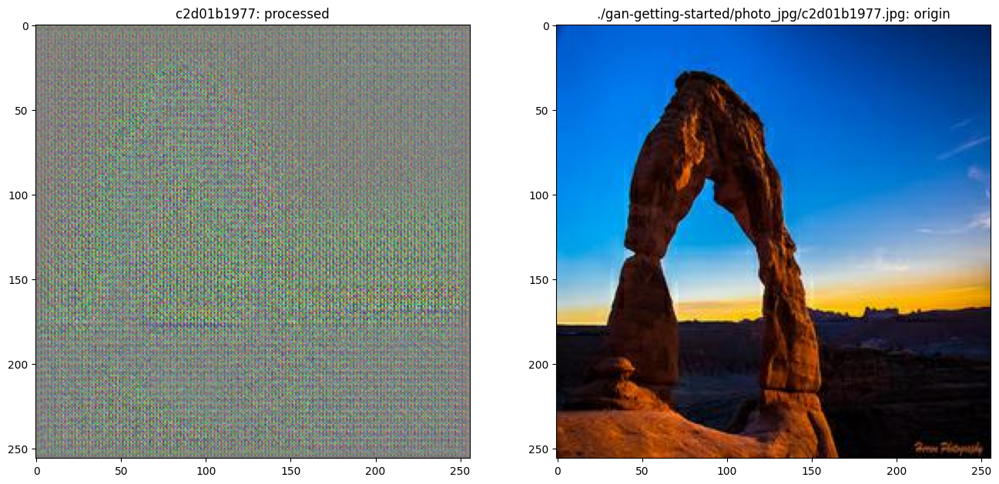

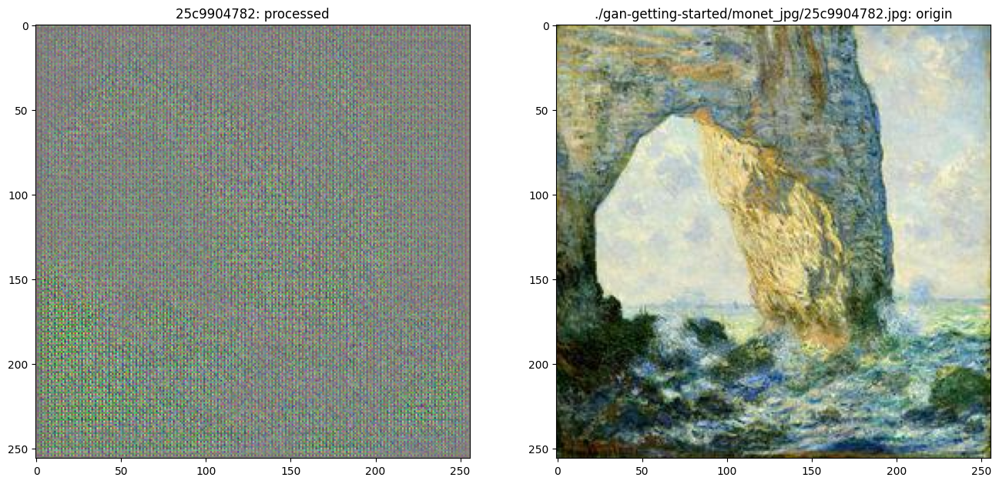

In [31]:
show_raw_image(sample_test_id, regen_sample_test, photo_jpg_dir, recover)
show_raw_image(sample_train_id, regen_sample_train, monet_jpg_dir, recover)

Check the output of the discriminator on the real image and the generated ones.

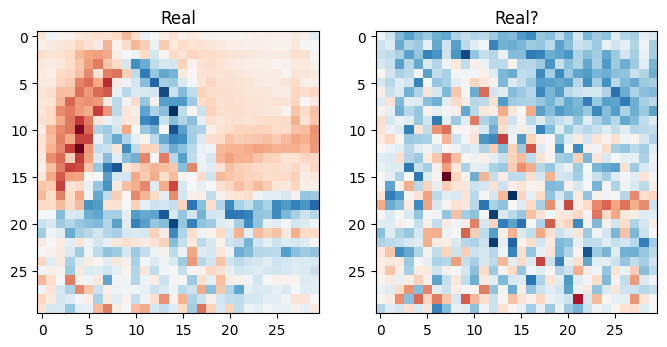

In [32]:
check_real = photo_discriminator(sample_test_image)
check_regen_real = photo_discriminator(regen_sample_test)
plt.figure(figsize=(8, 8))

plt.subplot(121)
plt.title('Real')
plt.imshow(check_real[0, ..., -1], cmap='RdBu_r')

plt.subplot(122)
plt.title('Real?')
plt.imshow(check_regen_real[0, ..., -1], cmap='RdBu_r')

plt.show()

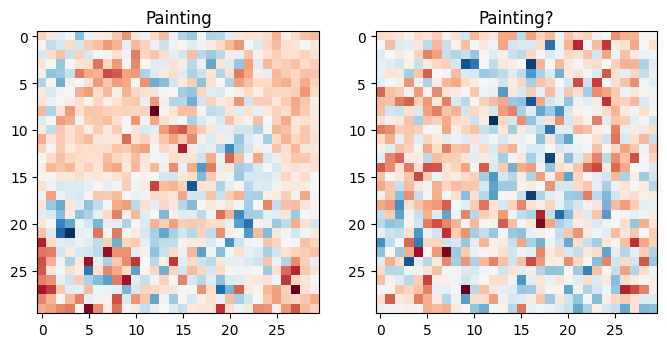

In [33]:
check_painting = monet_discriminator(sample_train_image)
check_regen_painting = monet_discriminator(regen_sample_train)
plt.figure(figsize=(8, 8))

plt.subplot(121)
plt.title('Painting')
plt.imshow(check_painting[0, ..., -1], cmap='RdBu_r')

plt.subplot(122)
plt.title('Painting?')
plt.imshow(check_regen_painting[0, ..., -1], cmap='RdBu_r')

plt.show()

Loss function and optimizer for cycle GAN in both directions. Refer to: https://www.tensorflow.org/tutorials/generative/cyclegan?authuser=8

In [34]:
LAMBDA = 10
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def discriminator_loss(real, generated):
    real_loss = loss_fn(tf.ones_like(real), real)

    generated_loss = loss_fn(tf.zeros_like(generated), generated)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss * 0.5

def generator_loss(generated):
    return loss_fn(tf.ones_like(generated), generated)

def cycle_loss(real_image, cycled_image):
    return LAMBDA *  tf.reduce_mean(tf.abs(real_image - cycled_image))

def identity_loss(real_image, same_image):
    return LAMBDA * 0.5 * tf.reduce_mean(tf.abs(real_image - same_image))

In [35]:
from tensorflow.keras.optimizers.legacy import Adam
optimizer_monet_genarator = Adam(2e-4, beta_1=0.5)
optimizer_photo_genarator = Adam(2e-4, beta_1=0.5)

optimizer_photo_discriminator = Adam(2e-4, beta_1=0.5)
optimizer_monet_discriminator = Adam(2e-4, beta_1=0.5)

In [36]:
checkpoint_path = data_root_dir + "checkpoints/"
if not os.path.exists(checkpoint_path):
    os.mkdir(checkpoint_path)

    
#x==>photo, y==>monet
#g==>photo to monet, f==>monet to photo
ckpt = tf.train.Checkpoint(generator_g=monet_generator,
                           generator_f=photo_generator,
                           discriminator_x=photo_discriminator,
                           discriminator_y=monet_discriminator,
                           generator_g_optimizer=optimizer_monet_genarator,
                           generator_f_optimizer=optimizer_photo_genarator,
                           discriminator_x_optimizer=optimizer_photo_discriminator,
                           discriminator_y_optimizer=optimizer_monet_discriminator)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


In [37]:
def generate_images(model, test_input):
    prediction = model(test_input)

    plt.figure(figsize=(12, 12))

    display_list = [test_input[0], prediction[0]]
    title = ['Input Image', 'Predicted Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.show()

Build the training functions refer to the tutorial.
Although the challenge is to generate Monet from regular photo, as mentioned in previous section, the CycleGAN will always perform training at both directions to adjust the parameters based on the self-regulated variances.
In brief, the training includes the following steps:
- Prediction: 
    Generate from instance of X to Y and then generate back from Y to X
    Same on the other cycle
- Loss calculation:
    Calculate the total loss at X and Y side
- Gradient calculation: 
    Calculate the gradient using back-propagation with the calculated loss
- Optimize and adjust the parameters based on the gradient values.


In [38]:

@tf.function
def train_step(real_photo, real_monet):
    #The trainning function is from the tutorial: https://www.tensorflow.org/tutorials/generative/cyclegan?authuser=8
    #To avoid too much code and change while keeping the semantic for the current practice, alias is added as following:
    #x==>photo, y==>monet
    #g==>photo to monet, f==>monet to photo
    real_x = real_photo
    real_y = real_monet
    generator_g = monet_generator
    generator_f = photo_generator
    generator_g_optimizer = optimizer_monet_genarator
    generator_f_optimizer = optimizer_photo_genarator
    
    discriminator_x = photo_discriminator
    discriminator_y = monet_discriminator
    discriminator_x_optimizer = optimizer_photo_discriminator
    discriminator_y_optimizer = optimizer_monet_discriminator
    
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X.

        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)

        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)

        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)

        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)

        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        # calculate the loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        total_cycle_loss = cycle_loss(real_x, cycled_x) + cycle_loss(real_y, cycled_y)

        # Total generator loss = adversarial loss + cycle loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, 
                                        generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, 
                                        generator_f.trainable_variables)

    discriminator_x_gradients = tape.gradient(disc_x_loss, 
                                            discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, 
                                            discriminator_y.trainable_variables)

    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, 
                                            generator_g.trainable_variables))

    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, 
                                            generator_f.trainable_variables))

    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,
                                                discriminator_x.trainable_variables))

    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,
                                                discriminator_y.trainable_variables))

Have a glance of the models before training.

In [39]:
monet_generator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 sequential (Sequential)        (None, None, None,   3072        ['input_1[0][0]']                
                                64)                                                               
                                                                                                  
 sequential_1 (Sequential)      (None, None, None,   131328      ['sequential[0][0]']             
                                128)                                                          

In [40]:
photo_generator.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 sequential_15 (Sequential)     (None, None, None,   3072        ['input_2[0][0]']                
                                64)                                                               
                                                                                                  
 sequential_16 (Sequential)     (None, None, None,   131328      ['sequential_15[0][0]']          
                                128)                                                        

In [41]:
saved_model_path = data_root_dir + 'models/'
saved_monet_generator = saved_model_path + "monet_generator"
saved_photo_generator = saved_model_path + "photo_generator"

Training and checking.

Although the model will calculate the loss and accuracy accordingly, to verify how the actual result looks like.
After the model is trained, it is used to generate the Monet painting from the regular photos (testing dataset). Then 3 images are randomly selected to check the results.
Based on the results, the model may be rerun with different epochs.
According to multiple tries, one of the best result is when the epoch is 23.

First time, start training.
..............................

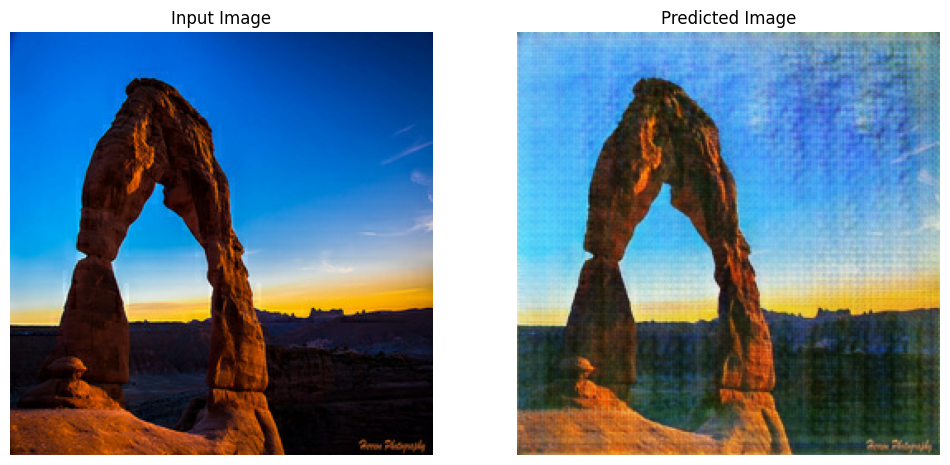

Time taken for epoch 1 is 217.00719618797302 sec

..............................

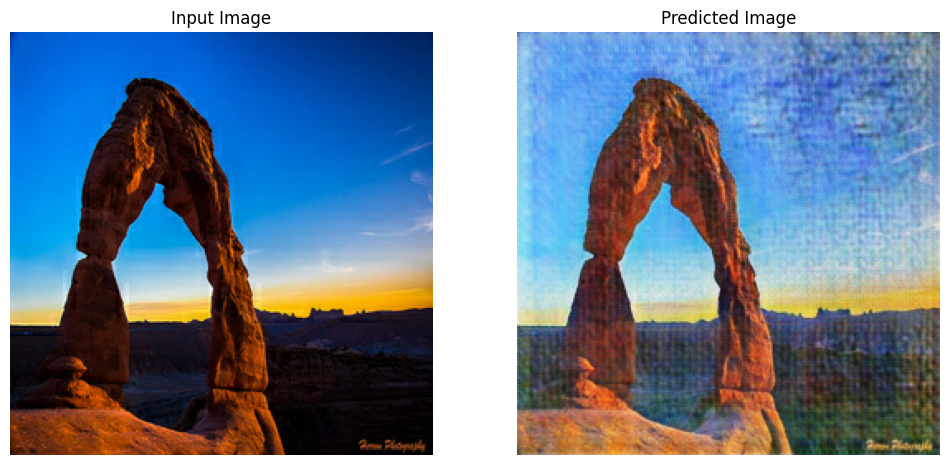

Time taken for epoch 2 is 219.01813507080078 sec

..............................

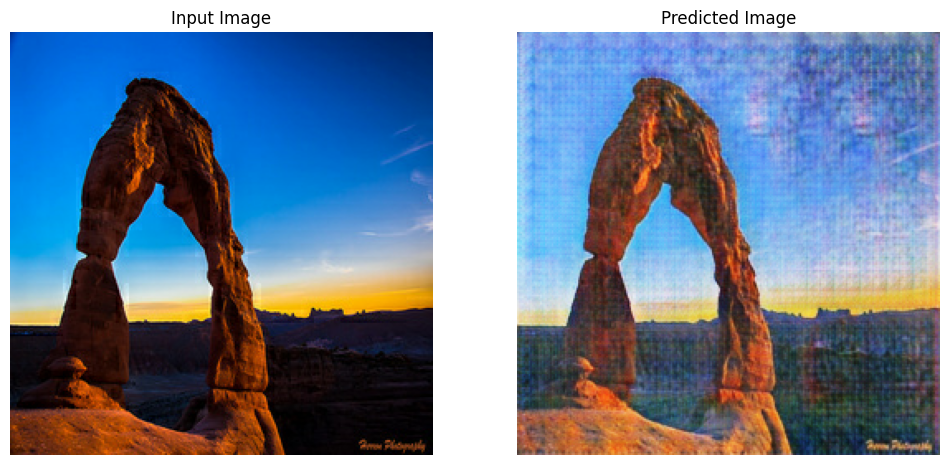

Time taken for epoch 3 is 247.89170217514038 sec

..............................

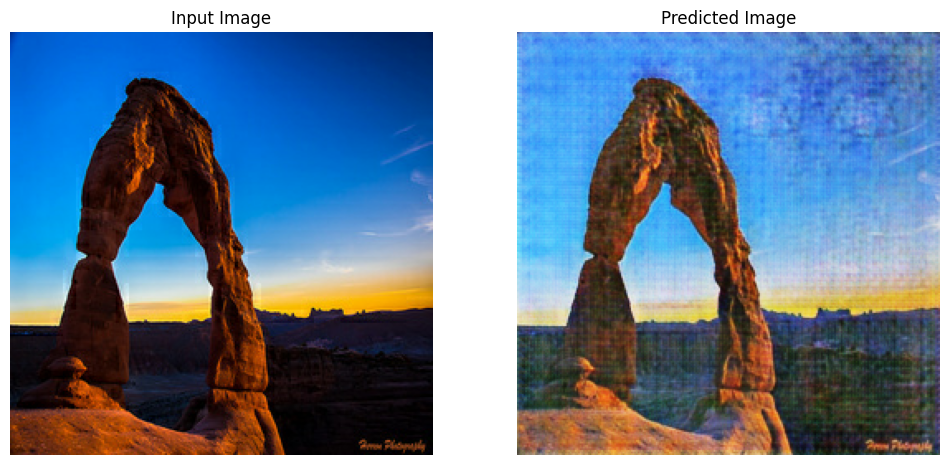

Time taken for epoch 4 is 355.05560088157654 sec

..............................

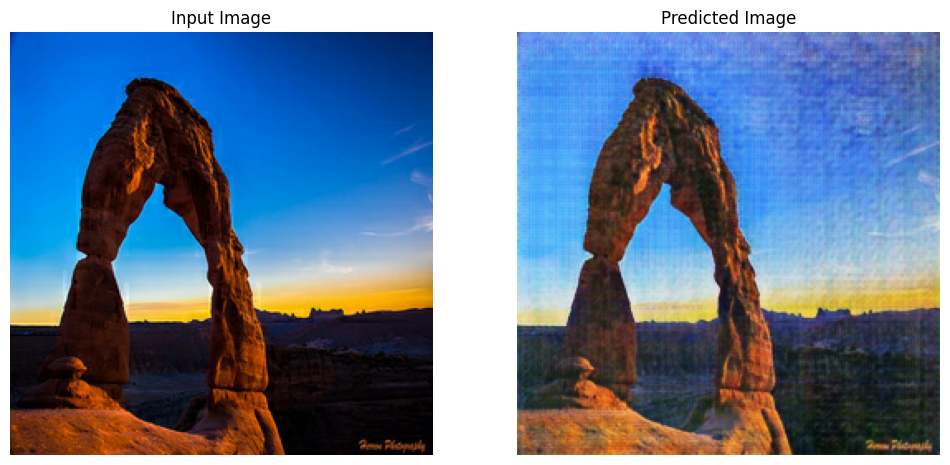

Saving checkpoint for epoch 5 at ./gan-getting-started/checkpoints/ckpt-8
Time taken for epoch 5 is 313.6506552696228 sec

..............................

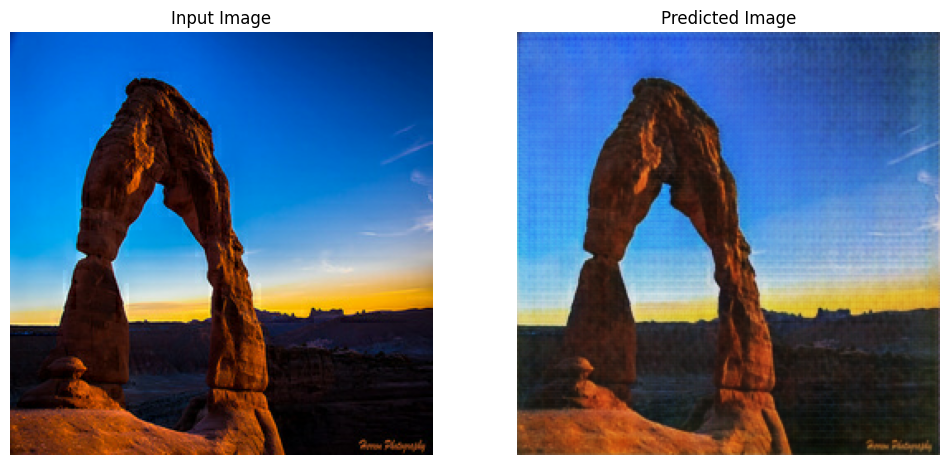

Time taken for epoch 6 is 257.073744058609 sec

..............................

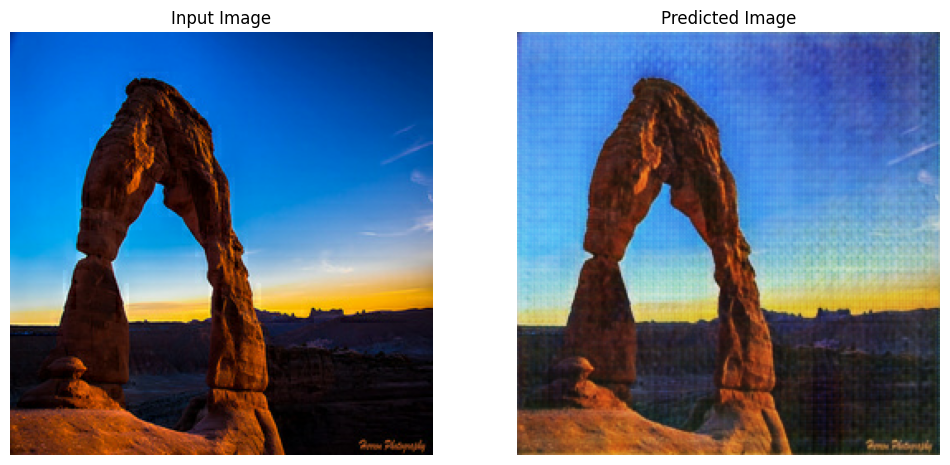

Time taken for epoch 7 is 274.47432923316956 sec

..............................

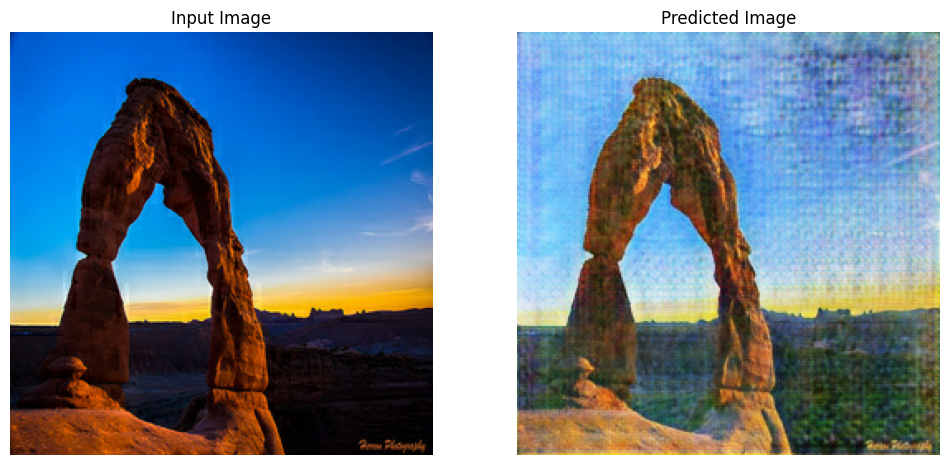

Time taken for epoch 8 is 323.91661977767944 sec

..............................

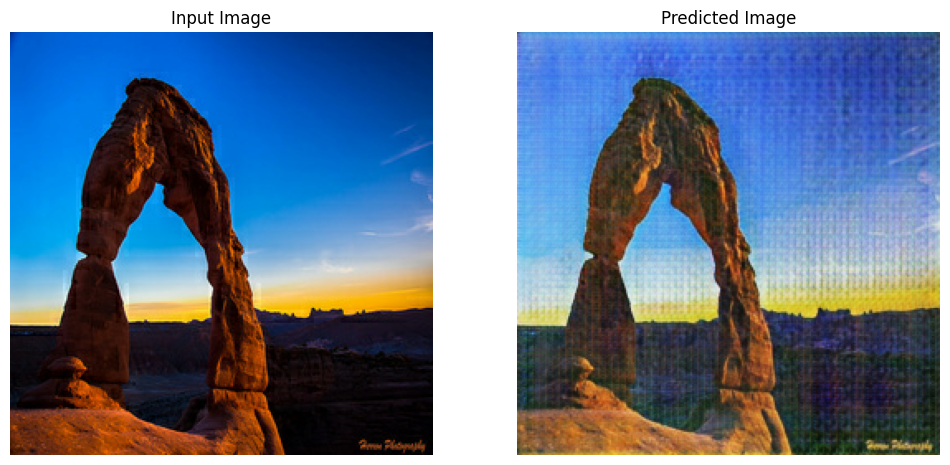

Time taken for epoch 9 is 275.6838037967682 sec

..............................

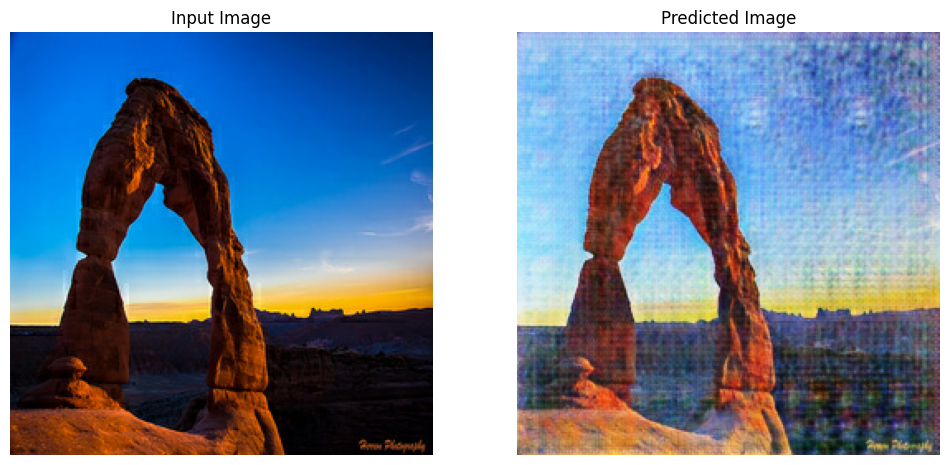

Saving checkpoint for epoch 10 at ./gan-getting-started/checkpoints/ckpt-9
Time taken for epoch 10 is 404.8281149864197 sec

..............................

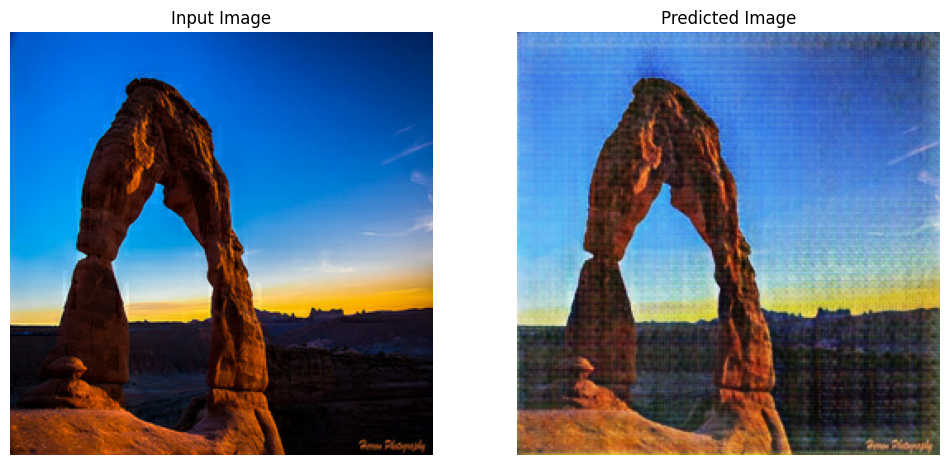

Time taken for epoch 11 is 366.9543159008026 sec

..............................

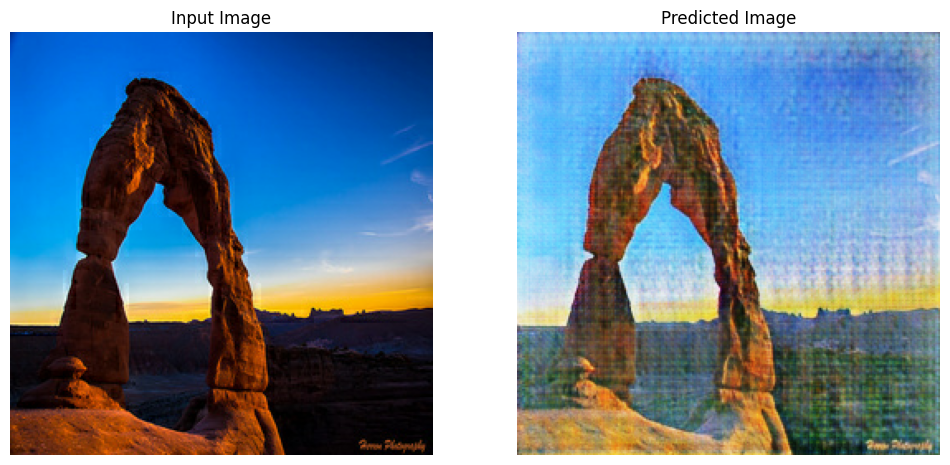

Time taken for epoch 12 is 409.2464048862457 sec

..............................

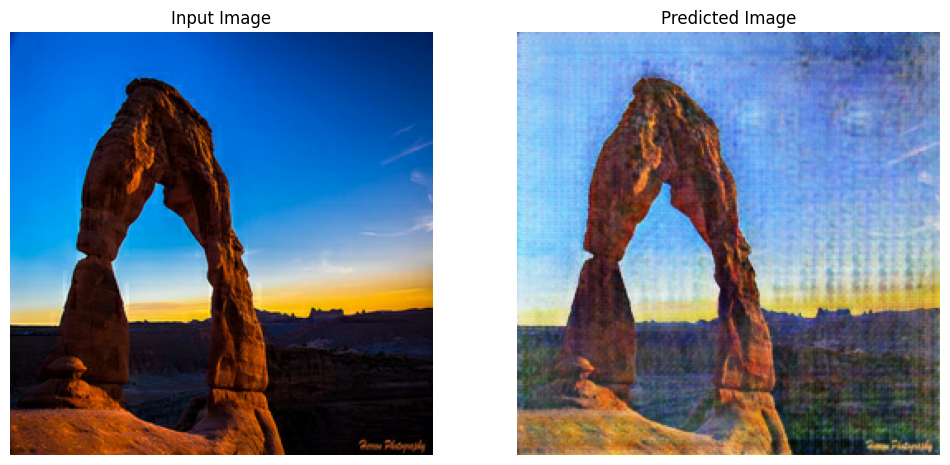

Time taken for epoch 13 is 341.83608293533325 sec

..............................

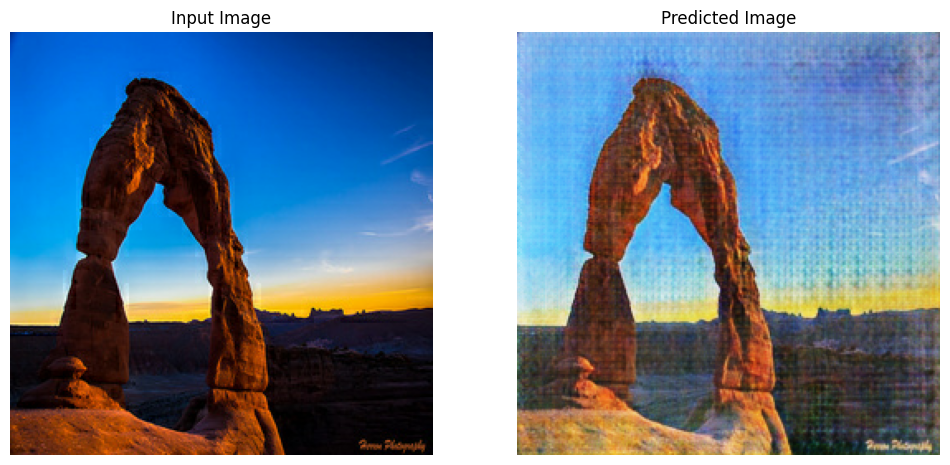

Time taken for epoch 14 is 357.5364787578583 sec

..............................

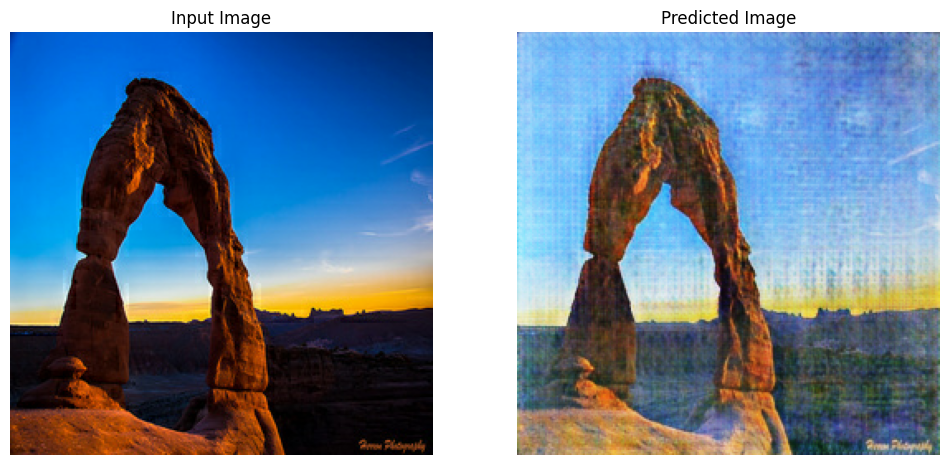

Saving checkpoint for epoch 15 at ./gan-getting-started/checkpoints/ckpt-10
Time taken for epoch 15 is 289.47242283821106 sec

..............................

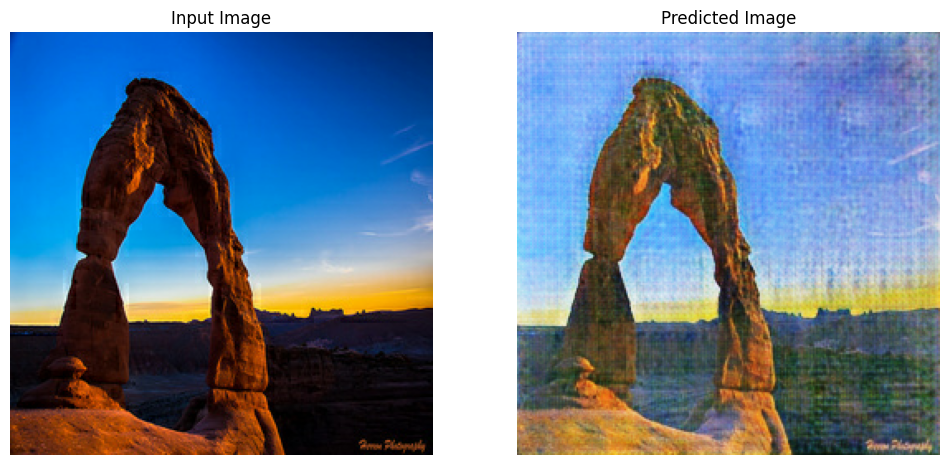

Time taken for epoch 16 is 296.21766090393066 sec

..............................

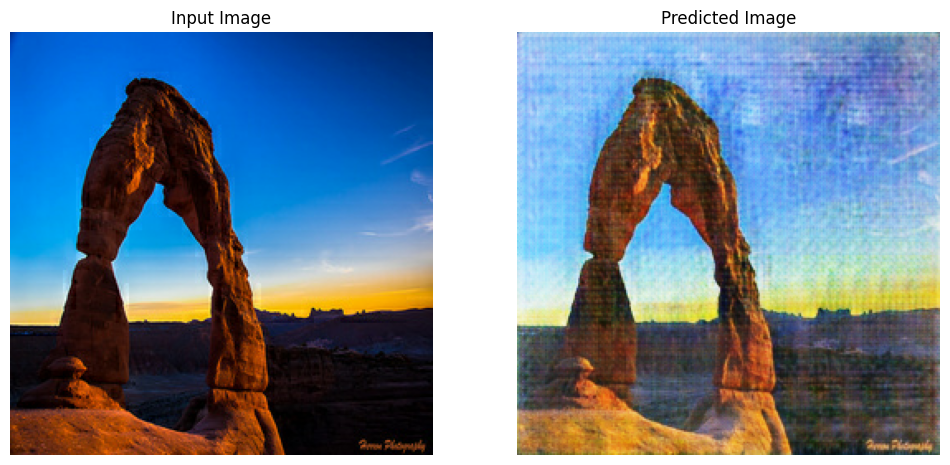

Time taken for epoch 17 is 283.6411876678467 sec

..............................

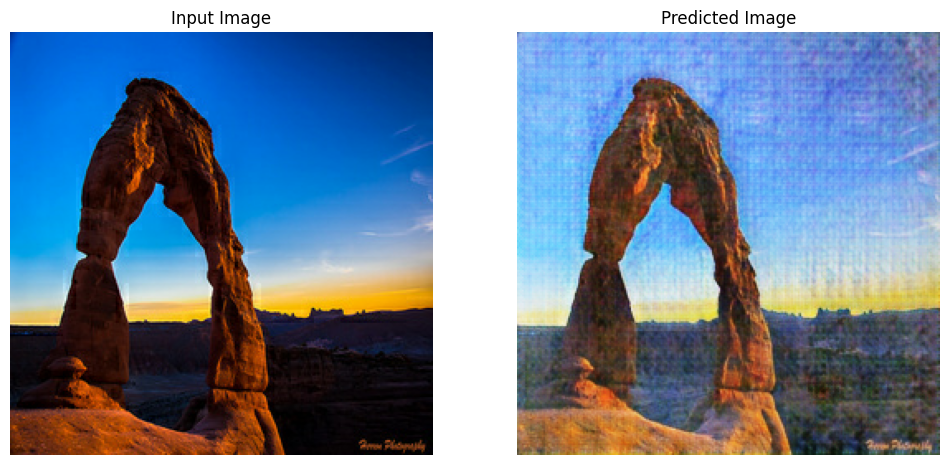

Time taken for epoch 18 is 321.9926619529724 sec

..............................

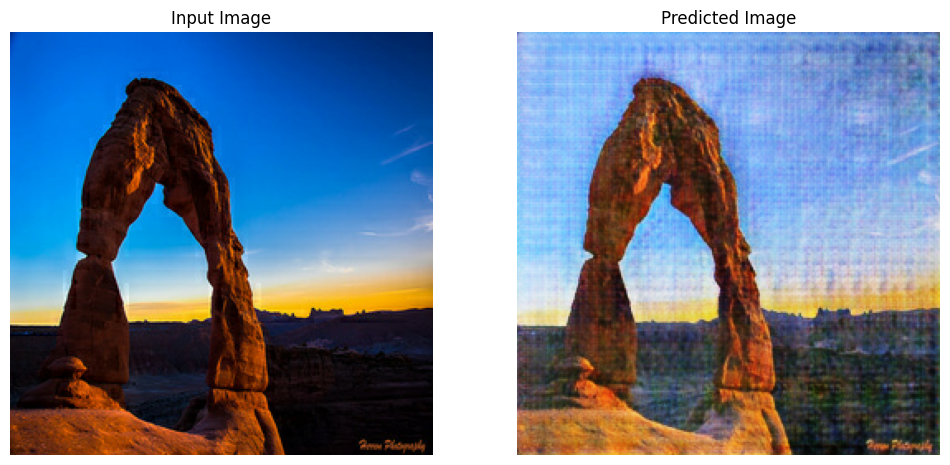

Time taken for epoch 19 is 285.5956630706787 sec

..............................

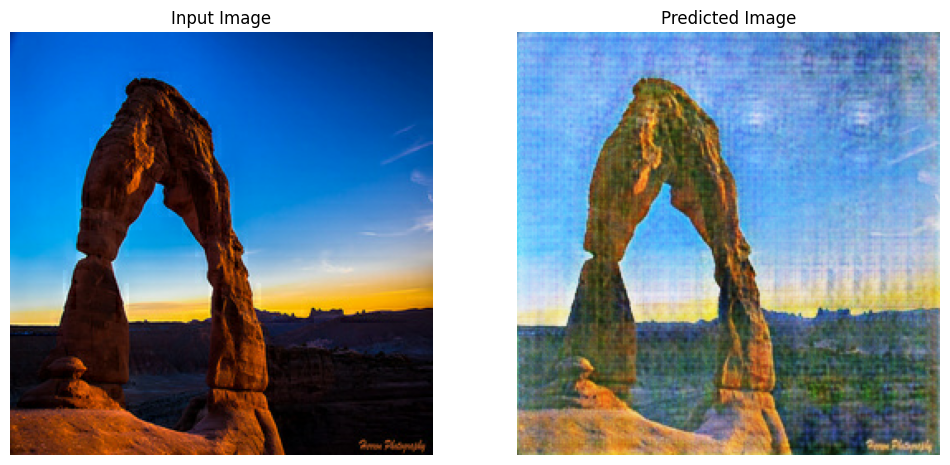

Saving checkpoint for epoch 20 at ./gan-getting-started/checkpoints/ckpt-11
Time taken for epoch 20 is 290.49302792549133 sec

..............................

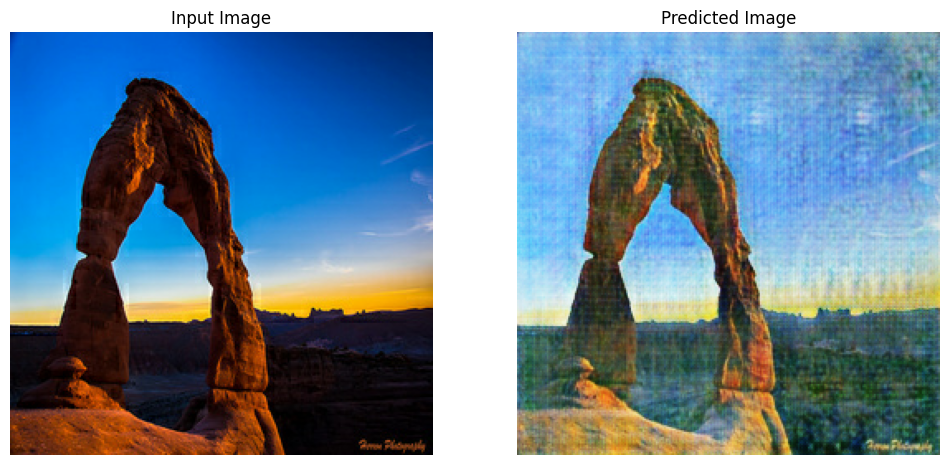

Time taken for epoch 21 is 303.1445438861847 sec

..............................

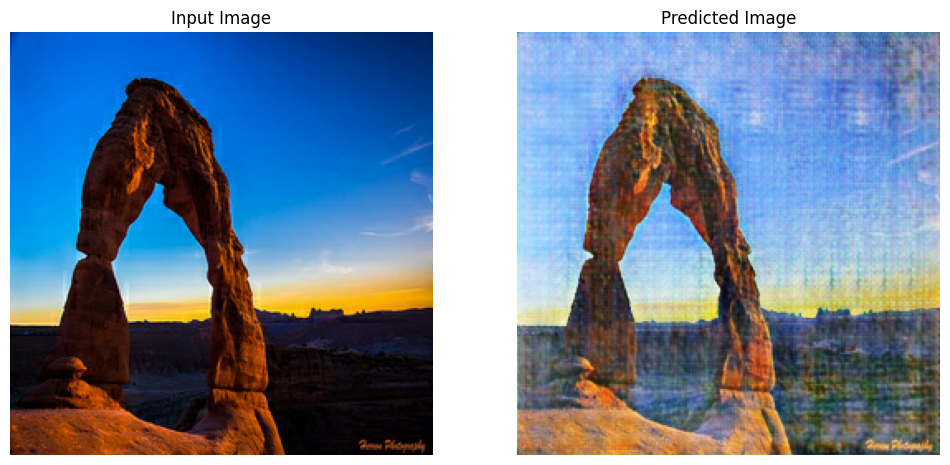

Time taken for epoch 22 is 279.08930587768555 sec

..............................

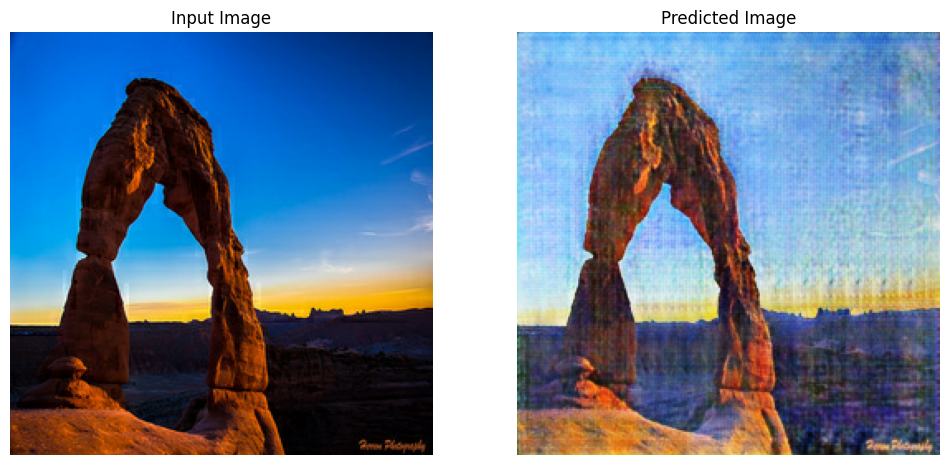

Time taken for epoch 23 is 296.39817690849304 sec

Time taken for 23 epochs is 7010.2246923446655 sec



In [66]:
if True: #not os.path.exists(saved_monet_generator):
    print("First time, start training.")
    try:
        os.makedirs(saved_model_path)
    except:
        pass
    
    EPOCHS = 23

    train_start = time.time()
    for epoch in range(EPOCHS):
        start = time.time()

        n = 0
        for image_x, image_y in tf.data.Dataset.zip((processed_test_ds, shuffled_train_ds)):
            train_step(image_x, image_y)
            if n % 10 == 0:
                print ('.', end='')
            n += 1

        #clear_output(wait=True)
        # Using a consistent image (sample_horse) so that the progress of the model
        # is clearly visible.
        generate_images(monet_generator, sample_test_image)

        if (epoch + 1) % 5 == 0:
            ckpt_save_path = ckpt_manager.save()
            print ('Saving checkpoint for epoch {} at {}'.format(epoch+1, ckpt_save_path))

        print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1, time.time()-start))

    print ('Time taken for {} epochs is {} sec\n'.format(EPOCHS, time.time()-train_start))
    
    #monet_generator.save(saved_monet_generator)
    #photo_generator.save(saved_photo_generator)
else:
    monet_generator = tf.keras.models.load_model(saved_monet_generator)
    photo_generator = tf.keras.models.load_model(saved_photo_generator)


Check the models once more after the training.

In [67]:
monet_generator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 sequential (Sequential)        (None, None, None,   3072        ['input_1[0][0]']                
                                64)                                                               
                                                                                                  
 sequential_1 (Sequential)      (None, None, None,   131328      ['sequential[0][0]']             
                                128)                                                          

In [68]:
photo_generator.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 sequential_15 (Sequential)     (None, None, None,   3072        ['input_2[0][0]']                
                                64)                                                               
                                                                                                  
 sequential_16 (Sequential)     (None, None, None,   131328      ['sequential_15[0][0]']          
                                128)                                                        

In [77]:
output_dir = data_root_dir + "submission/"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)


In [78]:
def regulate_image(normalized_img):
    return tf.cast((normalized_img+1) * 127.5, tf.uint8)

In [79]:
test_image_iter = iter(processed_test_ds)
test_id_iter = iter(test_id_ds)

Generate Monet paintings with the trained model, store the generated images to the output directory.

In [80]:
num = 0
try:
    while (True):
        img = next(test_image_iter)
        img_id = next(test_id_iter)
        img_num = len(img)
        for i in range(img_num):
            fake_monet = regulate_image(monet_generator(img, training=False))
            #show_raw_image(None, fake_monet, None, None)
            im = np.array(fake_monet[0])
            im = Image.fromarray(im)

            #print(img_id.numpy()[i].decode())
            fullname = os.path.join(output_dir + img_id.numpy()[i].decode() + ".jpg")
            im.save(fullname)


            num += 1
except Exception as e:
    print(f'caught {type(e)}: e')

print("{} of images are converted to monet painting in the directory: {}".format(num, output_dir))

caught <class 'StopIteration'>: e
7038 of images are converted to monet painting in the directory: ./gan-getting-started/submission/


In [81]:
#Verify
orig_photos = list(pathlib.Path(photo_jpg_dir).with_suffix('').glob('*.jpg'))
fake_monet_photos = list(pathlib.Path(output_dir).with_suffix('').glob('*.jpg'))
assert(len(orig_photos) == len(fake_monet_photos))

Randomly pick up 3 images to check.

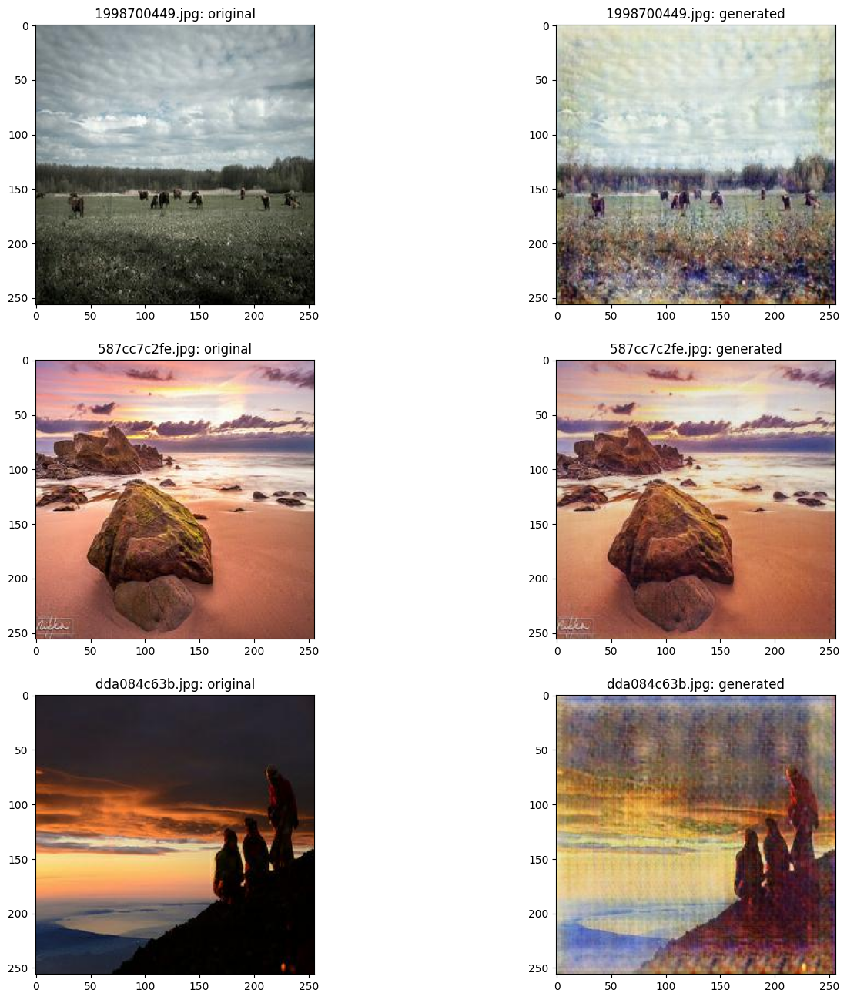

In [82]:
import random as rn
indice = rn.sample(range(0, len(orig_photos)), 3)
fig_width = 2
fig_height = len(indice)
fig = plt.figure(figsize=(16,16))
ax = fig.subplots(fig_height,fig_width)

for i in range(len(indice)):
    orig_jpg_fullname = str(orig_photos[indice[i]])
    fn = orig_jpg_fullname.split(os.sep)[-1]
    fake_monet_fullname = output_dir + fn
    #print(orig_jpg_fullname, fake_monet_fullname)
    
    with Image.open(orig_jpg_fullname) as img:
        ax[i][0].imshow((img))
        ax[i][0].set_title(fn + ": original")
    with Image.open(fake_monet_fullname) as img:
        ax[i][1].imshow((img))
        ax[i][1].set_title(fn + ": generated")

Compress the files for submitting.

In [83]:
import shutil
shutil.make_archive("./images", 'zip', output_dir)

'/Users/lorby/Projects/GitHub/msds/dl/week5/images.zip'

## Conclusion and Analysis
The overall result seems to be good with the photos which is more complicated. For the photos with less color and simpler, the generated paintings seemed to be no change.
May try some different models like resNet suggested in the paper [CycleGAN](https://arxiv.org/abs/1703.10593)  